# Understanding Junctions (Chains, Forks and Colliders) and the Role they Play in Causal Inference

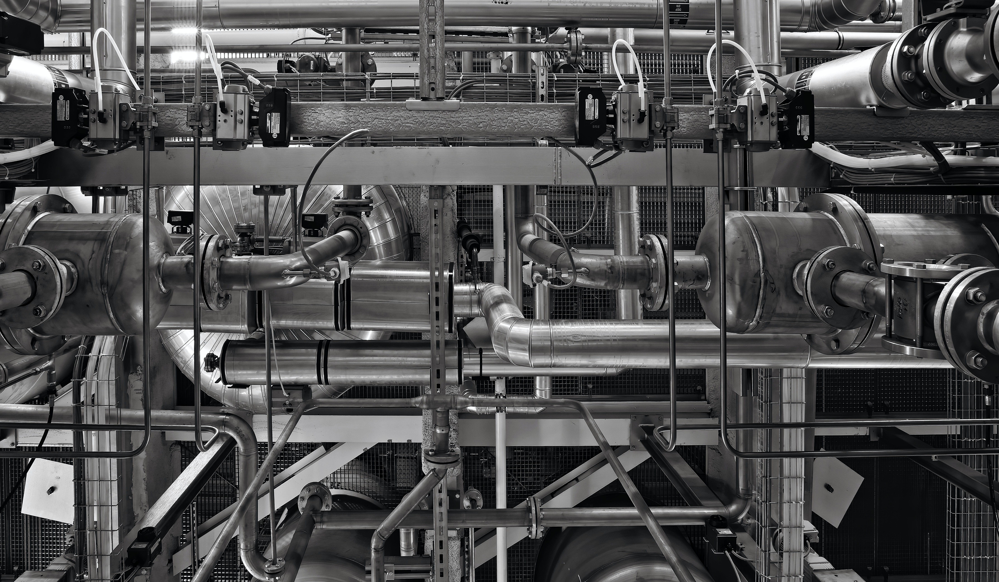
Photo by <a href="https://unsplash.com/@rgaleriacom?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Ricardo Gomez Angel</a> on <a href="https://unsplash.com/photos/stainless-steel-and-red-industrial-machine-41X6FwTwPh4?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>

## Introduction

Causal inference is the application of probability, visualisation and machine learning in understanding the answer to the question “why?”. It is a relatively new field of data science and offers the potential to extend the benefits of predictive algorithms which address the symptoms of an underlying business problem to permanently curing the business problem by establishing cause and effect.

Typically Causal Inference will start with a dataset (like any other branch of dataset) and then augment the data with a visual representation of the causes and effects enshrined in the relationship between the data items. A common form of this visualisation is the Directed Acyclic Graph or DAG. 

### The Problem
DAGs look deceptively simple but they hide a lot of complexity which must be fully understand to maximise the application of causal inference techniques.

### The Opportunity
Even the most complex DAGs can be broken down into a collection of junctions which can only be one of 3 patterns - a chain, a fork or a collider - and once those patterns are explained the more complex techniques can be built up, understood and applied.

### The Way Forward
This article will take the time to fully explain and understand the 3 patterns of junction setting the foundations for the reader to understand the detail of complex causal inference techniques.

In [1]:
import pandas as pd
import numpy as np
#import copy

#from typing import Tuple

import matplotlib.pyplot as plt

#import json

from icecream import ic

#import pickle

#from statsmodels.formula.api import ols
#from statsmodels.regression.linear_model import RegressionResultsWrapper

In [2]:
import sys
sys.path.insert(1, r'C:\\Users\\GHarr\\OneDrive - Lincoln College\\Python Projects\Data Science\\ghlibrary')

import dataframe_tools # type: ignore
from dag_tools import DirectedAcyclicGraph # type: ignore
from causal_tools import CausalModel # type: ignore
from misc_tools import calculate_percentage_accuracy # type: ignore

## Background

We are going to need an example DAG to explore and explain. I have constructed the fictitious DAG below because it is sufficiently simple to effectively explore the concepts and sufficiently complex to contain examples of all 3 types of junctions ...

A complex DAG taken from 'Causal Inference in Statistics' that includes 5 colliders, 3 forks and a chain between the treatment and outcome 



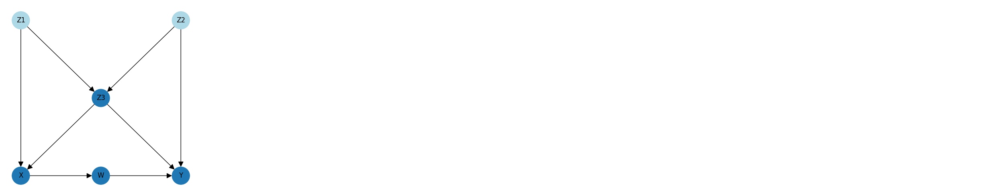

In [3]:
example_dag = DirectedAcyclicGraph.example_dags()["causal_inference_in_statistics_1"]
print(example_dag["description"], "\n")

dag: DirectedAcyclicGraph = example_dag["dag"]
dag.draw(grid_size=5)

This DAG represents the proposed causal relationships found within a dataset that contains 6 columns - X, Z1, Z2, Z3, W and Y. In all causal problems we are interested in the isolated effect of a treatment (in this case X) on an outcome (in this case Y).

The objective of causal inference is to establish the isolated effect of the treatment (X) and the outcome (Y) whilst adjusting for the effect of the other factors. For example in the proposed DAG Z3 is affecting both the treatment and the outcome and this would have to be accounted and adjusted for in any causal solution. 

"Treatment" and "effect" sound like medical terms and indeed the terminology is borrowed from the medical field as that is where a lot of the work originated. However it should be noted that Causal Inference is equally applicable to non-medical domains but by convention the terms "treatment" and "outcome" are used universally across all domains.

If you are wondering about the relationship between the DAG and the dataset, each node in the DAG represents a column in the data and each arrow is showing a proposed causal link i.e. data point X influences or causes data point W which in turn causes data point Y. The dataset for this DAG can be viewed as follows ...

In [4]:
causal_model: CausalModel = CausalModel(dag=dag, random_state=1)
causal_model.fit(X=None)
causal_model.data.head()

ic| 'CausalModel.fit'
ic| expr_str: 'Z3 = 3 x Z1 + -1.5 x Z2 + ε'
ic| expr_str: 'X = 2 x Z1 + 2.5 x Z3 + ε'
ic| expr_str: 'W = 3 x X + ε'
ic| expr_str: 'Y = 2 x W + 2 x Z2 + -3 x Z3 + ε'


,Z1,Z2,Z3,X,W,Y
0,3.844571,0.441614,12.794091,36.960446,115.415586,206.886397
1,2.907344,1.647342,4.678797,24.138748,82.681145,150.095276
2,6.241980,1.659767,16.349857,53.441608,193.360262,330.371609
3,0.793805,4.437415,-5.416621,-13.807977,-49.231954,-20.652048
4,7.754840,4.348612,16.867327,57.108005,171.713442,322.707828


The next concept is that there are many paths or routes through the DAG. Paths always start at the treatment, always end at the outcome and are acyclic (i.e. they do not loop back).

Given these concepts can you calculate how many possible paths exist in the example DAG?

The answer is 5 which can be visualised as follows ...

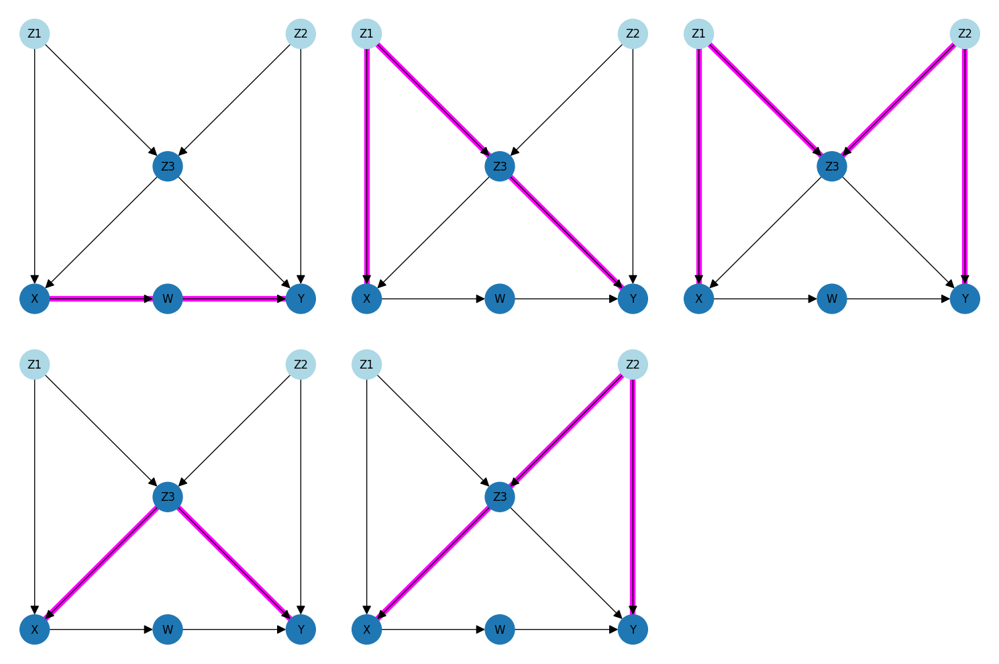

In [5]:
dag.draw_paths(paths=dag.all_paths(), cols=3)

It is also common to see paths represented in a flattened, textual form which can be confusing at first, but once explained they are very straightforward. The 5 paths shown visually above can be expressed in this form as follows ...

In [6]:
dag.print_paths(paths=dag.all_paths())

1) X -> W -> Y
2) X <- Z1 -> Z3 -> Y
3) X <- Z1 -> Z3 <- Z2 -> Y
4) X <- Z3 -> Y
5) X <- Z3 <- Z2 -> Y


The next step in understanding even the most complex DAGs is the concept of junctions. All DAGs and all paths within them are made up of junctions where each junction has exactly 3 nodes and 2 connections.

For example our first path (X -> W -> Y) is also a junction because it has exactly 3 nodes and exactly 2 connections.

Path 2 (X <- Z1 -> Z3 -> Y) is slightly more complicated; it contains 2 junctions - 

- X <- Z1 -> Z3
- Z1 -> Z3 -> Y

Path 3 (X <- Z1 -> Z3 <- Z2 -> Y) contains 3 junctions - 

- X <- Z1 -> Z3
- Z1 -> Z3 <- Z2
- Z3 <- Z2 -> Y

It is easy to understand the relationship between DAGs, paths and junctions by simply visualising all junctions in the example DAG ...

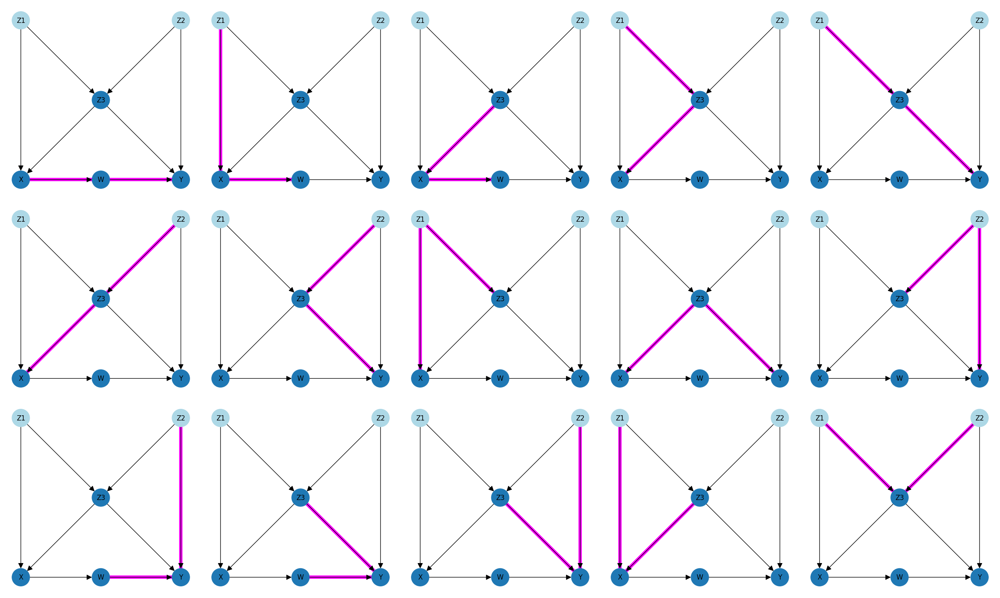

1) X -> W -> Y
2) Z1 -> X -> W
3) Z3 -> X -> W
4) Z1 -> Z3 -> X
5) Z1 -> Z3 -> Y
6) Z2 -> Z3 -> X
7) Z2 -> Z3 -> Y
8) X <- Z1 -> Z3
9) X <- Z3 -> Y
10) Y <- Z2 -> Z3
11) W -> Y <- Z2
12) W -> Y <- Z3
13) Z2 -> Y <- Z3
14) Z1 -> X <- Z3
15) Z1 -> Z3 <- Z2


In [7]:
dag.draw_paths(paths=dag.junctions, cols=5, print_paths=True)

It should be apparent from a quick review of all junctions within our DAG that there are just 3 possible patterns or types of junction.

Junction 1 (X -> W -> Y) is an example of a "chain" where the first node "points" to the intermediary (X -> W) and the intermediary "points" to the final node (W -> Y).

Junction 8 (X <- Z1 -> Z3) is an example of a "fork" where the intermediary node "points" to both the first node (X <- Z1) and the final node (Z1 -> X).

Junction 11 (W -> Y <- Z2) is an example of a "collider" where the first node "points" to the intermediary (W -> Y) and the final node also "points" to the intermediary (Y <- Z2).

It turns out that an understanding of these 3 patterns is critical to understanding many of the concepts of Causal Inference. 

For example Causal Validation is the process of validating the DAG against the dataset i.e. establishing if the proposed DAG is likely to be an accurate representation of the causal relationships between the columns in the data and the different behaviour of chains, forks and colliders is fundamental to understnading and implementing the calidation.

The remainder of this article is dedicated to exploring chains, forks and colliders in more details but before we get started let's take a short detour ...

## Detour 1: What Came First - The Chicken (The Data) or the Egg (The Directed Acyclic Graph)?

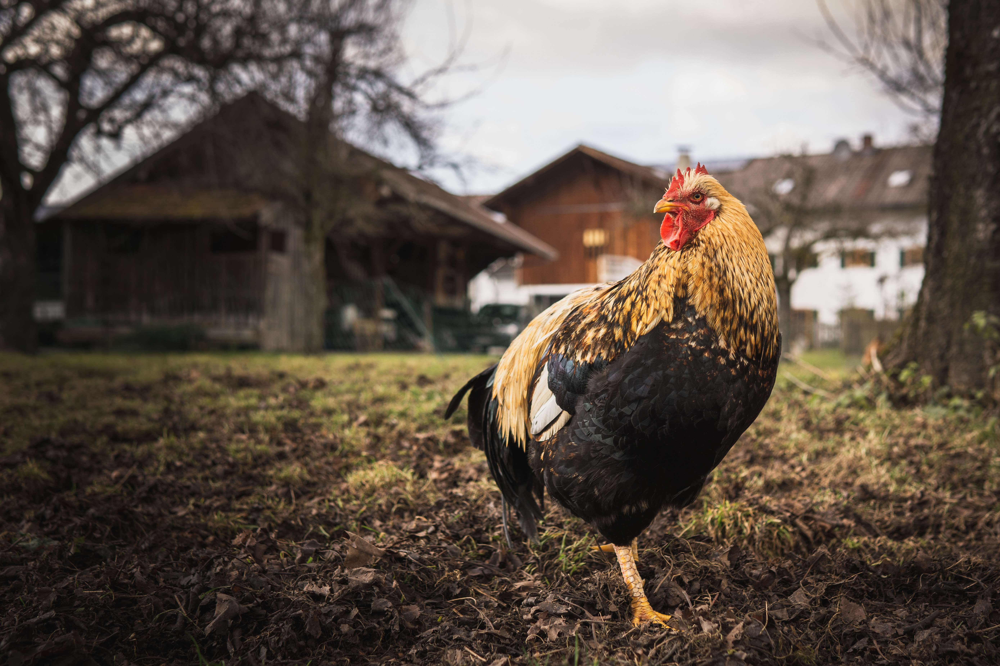
Photo by <a href="https://unsplash.com/@andretaissin?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Andre Taissin</a> on <a href="https://unsplash.com/photos/white-and-black-rooster-on-brown-soil-JXXRYrK2kGU?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>

One thing that tends not to be clarified in the available literature is the relationship between the dataset and the Directed Acyclic Graph and because it is usually the opposite way round in real life problems to theoretical problems it can easily get confusing and prevent the reader from understanding the key points.

Real-world Causal Inference problems are just an extension of more traditional machine learning problems (like classification or regression) but in Causal Inference we are interested in not just predicting what may happen but understanding why it happened in the first place.

Causal Inference problems therefore always start with a dataset, just like any other machine learning project. In order to answer the "why?" type problems the dataset must be associated with a Directed Acyclic Graph that captures and visualises the causal relationships that exist in the data and the DAG is usually created through an iterative refinement process involving data scientists asking the right questions and domain experts answering using their expertise. 

At some stage a refinement of the DAG will have been produced that all parties are happy with and then the process of solving Causal Inference problems begins.

It should also be noted that some automation can be brought to bear in the process of creating a DAG from a dataset. <b>Causal Discovery</b> is the concept of automatically generating a DAG from the data and <b>Causal Validation</b> is the process of testing a DAG against a dataset. It is typically possible for more than one DAG to satisfy the Causal Inference validation tests against a give dataset so these approaches are complex and uncertain. I will return to these concepts in future articles, but it is worth noting their existence as part of this explanation.

In theoretical Causal Infrence problems (like the ones in this article) the exact opposite is the case. This type of problem typically starts with the DAG like the 6-node example used throughout this article with the data scientist(s) selecting a DAG that can be used to illustrate the points or execute the tests.

So where does the data come from in theoretical CI problems when the DAG comes first? The data scientists(s) involved create a synthetic data set that matches the DAG and it turns out this can be done very easily by following these steps ...

1. Start with the fictitous / test DAG that requires an associated dataset ...

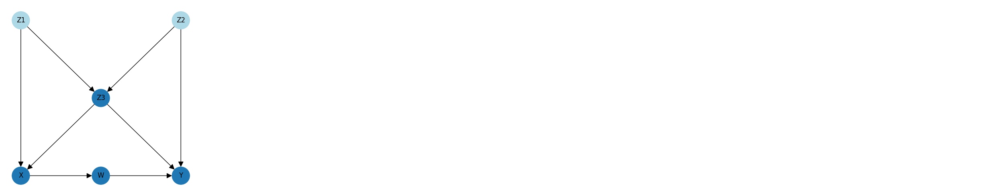

In [8]:
dag.draw(grid_size=5)

2. Attach a weigthing to each arrow on the DAG (the weightings can be selected at random)...

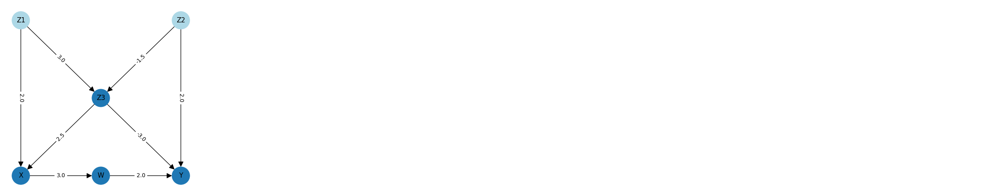

In [9]:
dag.draw(grid_size=5, labels=causal_model.edge_weightings)

3. Create a "structural equation" for each node by considering all of the incoming arrows and their associated weigthings ...

In [10]:
for key, structural_equation in causal_model.structural_equations.items():
    print(structural_equation)

Z1 = np.random.normal(4.753198042323167, 1.720324493442158)
Z2 = np.random.normal(3.289942920829799, 1.8849665188380633)
Z3 = 3 x Z1 + -1.5 x Z2 + ε
X = 2 x Z1 + 2.5 x Z3 + ε
W = 3 x X + ε
Y = 2 x W + 2 x Z2 + -3 x Z3 + ε


$$
Z1 \sim \mathcal{N}(4.75, 1.82^2) \\
Z2 \sim \mathcal{N}(3.29, 1.88^2) \\ 
$$

$$
Z3 = 3Z1 - 1.5Z2 + ε \\
X = 2Z1 + 2.5Z3 + ε \\
W = 3X + ε \\
Y = 2W + 2Z2 - 3Z3 + ε
$$

To complete the explanation all that is required is to understand the distinction between exogenous nodes / variables and endogenous variables / nodes. Exogenous nodes have no incoming causal arrows so in the example DAG the exogenous variables are Z1 and Z2 and the endogenous variables are X, W, Y and Z3. Exogenous variables must be assigned values randomly, usually by following a rule on a distribution.

The 6 structural equations (one for each node on the DAG) can therefore be fully explained and understood as follows ..

- Z1 is an exogenous variable (i.e. it has no inputs) that is normally distributed with a mean of 4.75 and a standard deviation of 1.82
- Z2 is an exogenous variable that is normally distributed with a mean of 3.29 and a standard deviation of 1.88

- Z3 = 3 X Z1 - 1.5 x Z2 + an error term
- X = 2 x Z1 + 2.5 x Z3 + an error term
- W = 3 x X + an error term
- Y = 2 x W + 2 x Z2 - 3 x Z3 + an error term

4. Generate the Data

Armed with this understanding it is very straightforward to write a few lines of Python to generate a dataset that exactly matches the test DAG where the causal relationships are described by the structural equations ...

Note that if ``np.random.seed(seed=...)`` is set the same data set will be generated each time the code is run, however if it is not set the dataset will be different each time (though each dataset generated will still be described by the structural equations and will match the DAG).

In [11]:
n=1000
df_test = pd.DataFrame()

np.random.seed(1)

df_test["Z1"] = np.random.normal(loc=4.753198042323167, scale=1.720324493442158, size=n)
df_test["Z2"] = np.random.normal(loc=3.289942920829799, scale=1.8849665188380633, size=n)

df_test["Z3"] = 3 * df_test["Z1"] - 1.5 * df_test["Z2"] 
error_terms = np.random.normal(loc=0, scale=df_test["Z3"].std()/4, size=n)
df_test["Z3"] += error_terms

df_test["X"] = 2 * df_test["Z1"] + 2.5 * df_test["Z3"] 
error_terms = np.random.normal(loc=0, scale=df_test["X"].std()/4, size=n)
df_test["X"] += error_terms

df_test["W"] = 3 * df_test["X"]
error_terms = np.random.normal(loc=0, scale=df_test["W"].std()/4, size=n)
df_test["W"] += error_terms

df_test["Y"] = 2 * df_test["W"] + 2 * df_test["Z2"] - 3 * df_test["Z3"] 
error_terms = np.random.normal(loc=0, scale=df_test["Y"].std()/4, size=n)
df_test["Y"] += error_terms

df_test

,Z1,Z2,Z3,X,W,Y
0,7.547599,3.001098,18.849516,61.877646,183.687041,294.732626
1,3.700778,-1.295254,13.390771,41.798499,127.359007,238.927669
2,3.844571,4.247476,4.514050,23.340019,74.344729,116.672140
3,2.907344,2.679153,3.819439,21.705897,75.779156,128.142202
4,6.241980,0.441614,15.126045,52.637599,166.012475,302.428980
...,...,...,...,...,...,...
995,4.552876,3.645415,7.073526,26.232212,100.939701,193.316114
996,0.835507,4.347255,-4.915390,-14.868783,-36.751659,-61.463007
997,4.633421,1.552646,11.353279,33.914154,90.985310,134.501006
998,5.361970,4.510223,7.294643,31.742129,110.265684,188.822793


In [12]:
causal_model.data

,Z1,Z2,Z3,X,W,Y
0,3.844571,0.441614,12.794091,36.960446,115.415586,206.886397
1,2.907344,1.647342,4.678797,24.138748,82.681145,150.095276
2,6.241980,1.659767,16.349857,53.441608,193.360262,330.371609
3,0.793805,4.437415,-5.416621,-13.807977,-49.231954,-20.652048
4,7.754840,4.348612,16.867327,57.108005,171.713442,322.707828
...,...,...,...,...,...,...
995,4.633421,5.904063,5.465877,23.658204,79.602500,125.114282
996,5.361970,4.212665,9.212642,31.732316,89.867887,194.437821
997,4.431575,3.740065,9.770078,34.221805,121.876436,241.395009
998,4.489582,2.445267,8.361504,32.488949,85.694711,98.286147


Once examples have been provided and worked through it is easy to understand the difference between real-world CI problems where the data has been collected first and the DAG dveloped by experts second, and theoretical / example CI problems where the test DAG is created first and then the test data engineered to match the DAG afterwards.

However, this explanation is often skipped in many of the available texts books and online articles which will lead to a lack of understanding of everything that follows.

Now this detour is complete, let's progress to an in-depth exploration of chains, forks and colliders.

In [13]:
random_seed = 100

def create_display_model(dag_name: str, display_results: bool = True, override_random_seed: int = None) -> CausalModel:
    """Create and display a model frm the collection of example DAGs

    Args:
        dag_name (str): The name of the DAG in example dags

    Returns:
        CausalModel: A causal model built using the named example DAG containing fitted example data
    """
    # Extract the example DAG and draw it
    dag = DirectedAcyclicGraph.example_dags()[dag_name]["dag"]

    global random_seed
    random_seed+=1

    # Instantiate a causal model based on the named DAG and fit it with auto-generated test data
    causal_model = CausalModel(dag=dag, random_state=random_seed if override_random_seed is None else override_random_seed)
    causal_model.fit(X = None)

    if display_results:
        dag.draw(grid_size=5, labels=causal_model.edge_weightings)
        plt.show()

        display(causal_model.data)

        # Draw a 4-way scatter of the single junction represented by the DAG (as those chosen in this notebook are all single-junction DAGs)
        causal_model.scatter_junction(junction = dag.junctions[0])
        plt.show()

    return causal_model # Return the causal model

## Chains

Let's start by reviewing a visualisation of a chain ...


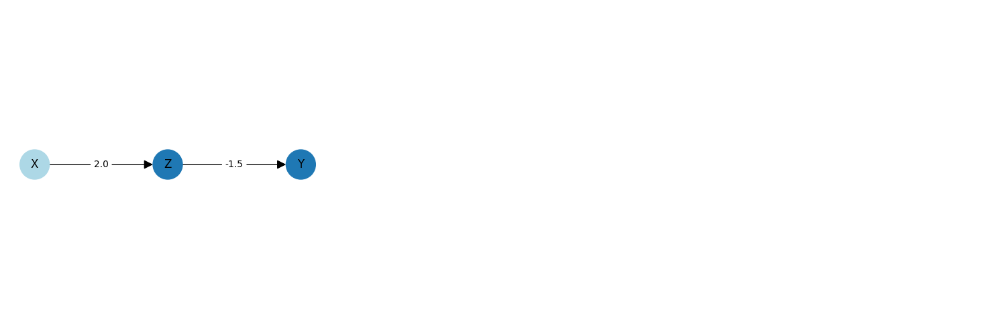

In [14]:
ic.disable()

chain_causal_model = create_display_model("simple_chain", display_results=False, override_random_seed=101)
chain_causal_model.dag.draw(grid_size=3, labels=chain_causal_model.edge_weightings)

The "chain" is the most straightforward pattern for a junction and is easy to understand. In our example "X" is the "treatment" variable, "Y" is the outcome and "Z" is the intermediary. To provide an example X represents the amount of a drug that was taken in a trial, Z represents the affect the drug had on the patients blood pressure and Y represents the change in patient outcome.

In the literature we are told that in a chain messages can pass from X to Y but when I first read the literature I did not understand what this meant. There was no explanation of what a message was or how it might be passed from the treatment to the outcome.

Put simply the definition of message passing is that if the value of variable X changes then the value of Y is changed and whilst this can be a difficult concept there are 4 different ways to visualise this defintion which when considered together provide a comprehensive explanation.

### Using Maths

In our example Z = 2X and Y = -1.5Z and these two equations can be solved using substitution as follows -

$$
\begin{array}{l}
⓵ \ Z = 2X \\

⓶ \ Y = -1.5Z \\ \\

Y = -1.5 \times 2X \ \ \ \text{(taking equation ⓶ and substituting Z for 2X from equation ⓵)} \\
Y = -3X
\end{array}
$$

This also makes intuitive sense from the DAG above because the 2 weightings on the arrows are just multiplied together to reveal the effect of changing X on Y.

The maths can be validated by creating a calculated column in the data by multiplying X by -3. The calculated column can then be compared to the value for Y noting that the structural equations include error terms so the calculated column should be close to the value of Y but will never be an exact match ...

In [15]:
test_data = chain_causal_model.data.copy(deep=True)
test_data["X * -3"] = test_data["X"] * -3
test_data["difference"] = abs(test_data["X * -3"] - test_data["Y"])
test_data

,X,Z,Y,X * -3,difference
0,7.073706,14.421021,-21.895914,-21.221117,0.674796
1,6.438930,11.780809,-19.997919,-19.316791,0.681128
2,6.670278,13.736251,-18.506942,-20.010833,1.503891
3,5.146045,10.285976,-12.651194,-15.438135,2.786941
4,4.315541,7.469024,-11.660516,-12.946622,1.286106
...,...,...,...,...,...
995,5.959337,12.859272,-17.551811,-17.878011,0.326199
996,6.662308,12.689145,-19.714022,-19.986923,0.272901
997,5.080409,9.902116,-15.474873,-15.241228,0.233645
998,6.671077,13.330932,-19.486743,-20.013232,0.526489


### Using Correlation

If there is an association between X and Y then this should be clearly visible if we plot the data points for X on the X axis against the data points for Y on the Y axis and also the line that best fits those datapoints should have a co-efficient that matches our calculated value for the effect of X on Y ...

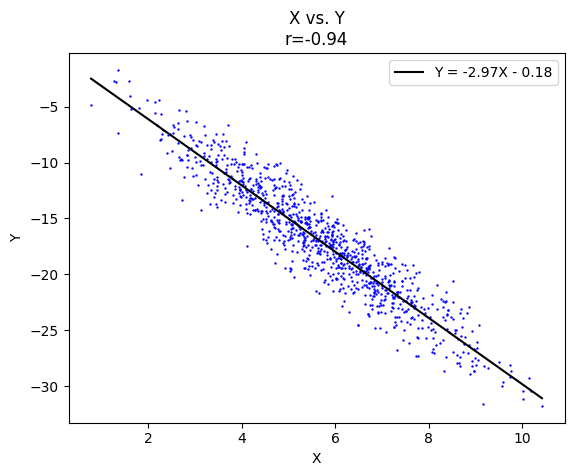

In [16]:
chain_causal_model.scatter_treatment_outcome(title="X vs. Y\n")

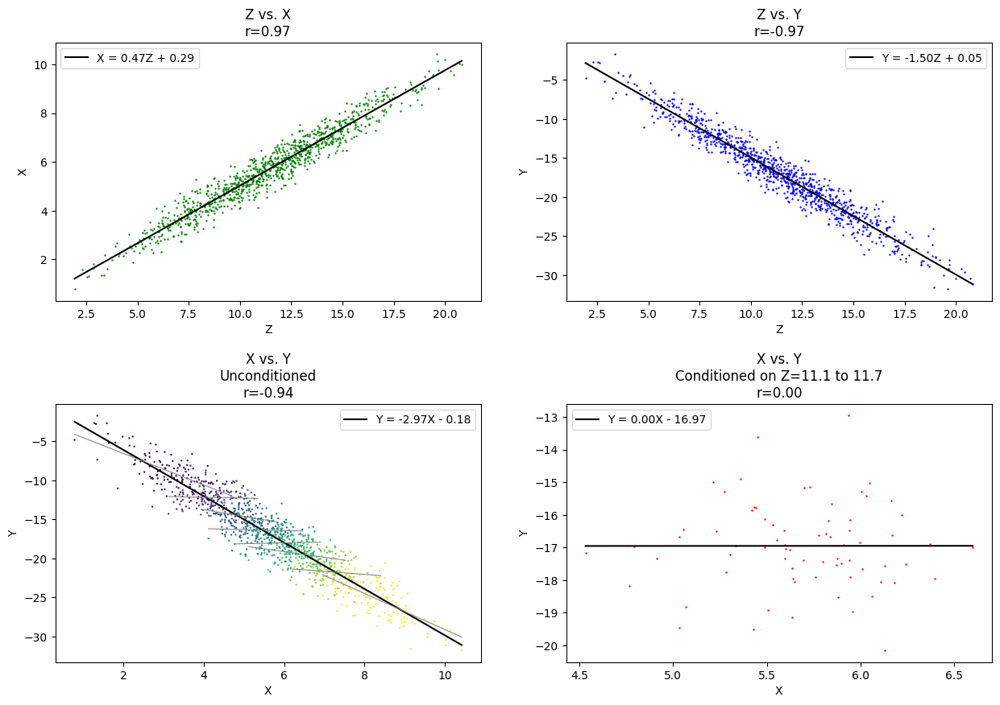

In [17]:
chain_causal_model.scatter_junction(junction = chain_causal_model.dag.junctions[0])

The scatter chart of X vs. Y confirms the maths and the co-efficient of the line is -2.97 which is very close to the result from the maths of -3 noting again that the presence of error terms in the structural equations that were used to generate the data mean they will never match exactly.

### Using Dependence

In a recent article I explained and explored the concept of dependence and why it is important in causal inference and causal validation - 

https://towardsdatascience.com/demystifying-dependence-and-why-it-is-important-in-causal-inference-and-causal-validation-4263b18d5f04

That understanding leads to another notation for expressing the reationship between X and Y in the chain junction ...

$$
% \perp is the ⊥ symbol, \!\!\! reverses 3 intervals and overlays another ⊥ giving ⫫
% \perp is ⊥ symbol then \!\!\!\!\!\! reverses 6 intervals, / is a sepeartor and finaly \ adds the slash giving ⫫̸
\providecommand{\independent}{\perp \!\!\! \perp}
\providecommand{\dependent}{\independent \!\!\!\!\!\! / \ }
\providecommand{\independentsingle}{\perp}
\providecommand{\dependentsingle}{\perp \!\!\!\!\!\! / \ }
\providecommand{\given}{\mid}
$$

$$
Y \dependent X
$$

... which can be read as "Y is dependent on X" (the ⫫̸ symbol is a "slashed double up-tack" and is used to represent dependence)

In [18]:
df_data = chain_causal_model.data

is_dependent_on_unconditioned, _, ols_results = df_data.dependence(expression="Y ⫫̸ X")
is_independent_on_unconditioned, _, ols_results = df_data.dependence(expression="Y ⫫ X")

is_dependent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫̸ X | Z")
is_independent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫ X | Z")

print(is_dependent_on_unconditioned)
print(is_independent_on_unconditioned)
print()
print(is_dependent_on_conditioned)
print(is_independent_on_conditioned)


True
False

False
True


### Using Regression

The final method of highlighting the relationship between between X and Y is to perform an Ordinary Least Squares (OLS) regression and to see if the relationship exists in the output.

To implement this for our chain it is a simple matter of regresing on Y ~ X using the following Python code ...

In [19]:
from statsmodels.formula.api import ols

ols_formula = "Y ~ X"
ols_results = ols(ols_formula, df_data).fit()

ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.877
Model:                            OLS   Adj. R-squared:                  0.877
Method:                 Least Squares   F-statistic:                     7129.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:16   Log-Likelihood:                -2022.9
No. Observations:                1000   AIC:                             4050.
Df Residuals:                     998   BIC:                             4060.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.1767      0.208     -0.850      0.396      -0.585       0.231
X             -2.9658      0.035    -84.431      0.000      -3.035      -2.897
==============================================================================
Omnibus:                        5.860   Durbin-Watson:                   1.963
Prob(Omnibus):                  0.053   Jarque-Bera (JB):                5.952
Skew:                          -0.185   Prob(JB):                       0.0510
Kurtosis:                       2.919   Cond. No.                         21.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We can see from the results that the co-efficient of the line describing the effect of X on Y is -2.9658 which was plotted on the correlation above.

### Testing

It would be very useful to know how accurate the detection of chains is so I designed a test harness that works as follows ...

1. Create a chain DAG.
2. Randomly generate the weightings on each causal arrow.
3. Generate a set of test data from those weightings.

AT THIS POINT WE KNOW WE HAVE A SET OF DATA AND A DAG THAT MATCH FOR THE CHAIN PATTERN X -> Z AND Z -> Y.

4. Now Use the dependency method from above to test these conditions ...
    - Test for Y ⫫̸ X (i.e that Y is dependent on X).
    - Test for Y ⫫ X | Z (i.e. that Y is independent of X when conditioned on Z).

IF BOTH THESE CHECKS ARE TRUE THEN THE DEPENDENCY CHECKS HAVE CONFIRMED THAT THE CONDITIONS FOR A CHAIN EXIST IN THE DATA.

5. Assess the true value of the effect of X on Y by multiplying the weightings together from the structural equations that were used to build the test data (see the maths section above).
6. Now run the regression test from the test data using the ordinary least squares method.

COMPARE THE TRUE VALUE OF THE EFFECT OF X ON Y TO THE REGRESSION TEST VALUE TO ASSESS THE ACCURACY OF THE REGRESSION TEST METHOD

8. Repeat steps 2. to 6. 100 times.
9. Review the results.

The results are that the dependency tests passed successfully in 100% of test cases and the calculated value for the effect of X on Y was 99.2% accurate

In [20]:
def test_chain(n_tests: int = 100):
    ic.disable()
    chain_tests_passed = 0
    accuracies = []

    for _ in range(n_tests):
        chain_causal_model = create_display_model("simple_chain", display_results=False)


        is_independent_on_unconditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫ X")
        is_independent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫ X | Z")
        is_dependent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫̸ X | Z")
        is_dependent_on_unconditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫̸ X")

        if (is_dependent_on_conditioned == is_independent_on_conditioned):
            print(random_seed)
            
        if (is_dependent_on_unconditioned == True) and (is_independent_on_conditioned == True):
        #if (is_dependent_on_unconditioned == True) and (is_dependent_on_conditioned == False):

            chain_tests_passed += 1

            r_zx = chain_causal_model.edge_weightings[("X", "Z")]
            r_yz = chain_causal_model.edge_weightings[("Z", "Y")]
            r_yx = r_zx * r_yz

            ols_change = ols_results.params["X"]

            accuracies.append(calculate_percentage_accuracy(ols_change, r_yx))

    print(f"Chain tests: {chain_tests_passed}/{n_tests} passed ({chain_tests_passed/n_tests:.1%})")
    print(f"The calculated effect of X on Y is {np.mean(np.array(accuracies)):.1%} accurate")

    ic.enable()

    return

In [21]:
random_seed = 100
test_chain()

113
130
151
158
163
187
Chain tests: 100/100 passed (100.0%)
The calculated effect of X on Y is 99.2% accurate


In [22]:
chain_causal_model = create_display_model("simple_chain", display_results=False, override_random_seed=1149)

is_independent_on_conditioned, _, ols_results_independent = chain_causal_model.data.dependence(expression="Y ⫫ X | Z")
is_dependent_on_conditioned, _, ols_results_dependent = chain_causal_model.data.dependence(expression="Y ⫫̸ X | Z")

print(is_independent_on_conditioned)
print(is_dependent_on_conditioned)


ic| 'CausalModel.fit'
ic| expr_str: 'Z = 3 x X + ε'
ic| expr_str: 'Y = 2 x Z + ε'
ic| expression: 'Y ⫫ X | Z'
ic| expression: 'Y ⫫̸ X | Z'


True
True


In [23]:
is_independent_on_conditioned, _, ols_results_independent = chain_causal_model.data.dependence(expression="Y ⫫ X | Z")
is_independent_on_conditioned


ic| expression: 'Y ⫫ X | Z'


True

In [24]:
is_dependent_on_conditioned, _, ols_results_dependent = chain_causal_model.data.dependence(expression="Y ⫫̸ X | Z")
is_dependent_on_conditioned


ic| expression: 'Y ⫫̸ X | Z'


True

In [25]:
ols_results_independent.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                     8672.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:21   Log-Likelihood:                -2347.5
No. Observations:                1000   AIC:                             4701.
Df Residuals:                     997   BIC:                             4716.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0327      0.141     -0.232      0.816      -0.309       0.244
X             -0.4415      0.193     -2.287      0.022      -0.820      -0.063
Z              2.1683      0.062     34.915      0.000       2.046       2.290
==============================================================================
Omnibus:                        1.867   Durbin-Watson:                   1.992
Prob(Omnibus):                  0.393   Jarque-Bera (JB):                1.863
Skew:                          -0.063   Prob(JB):                        0.394
Kurtosis:                       2.831   Cond. No.                         24.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [26]:
ols_results_dependent.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                     8672.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:21   Log-Likelihood:                -2347.5
No. Observations:                1000   AIC:                             4701.
Df Residuals:                     997   BIC:                             4716.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0327      0.141     -0.232      0.816      -0.309       0.244
X             -0.4415      0.193     -2.287      0.022      -0.820      -0.063
Z              2.1683      0.062     34.915      0.000       2.046       2.290
==============================================================================
Omnibus:                        1.867   Durbin-Watson:                   1.992
Prob(Omnibus):                  0.393   Jarque-Bera (JB):                1.863
Skew:                          -0.063   Prob(JB):                        0.394
Kurtosis:                       2.831   Cond. No.                         24.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [27]:
test_chain()

203
204
208
247
261
264
271
Chain tests: 100/100 passed (100.0%)
The calculated effect of X on Y is 99.1% accurate


## Detour 2: The Effect of Conditioning on Z

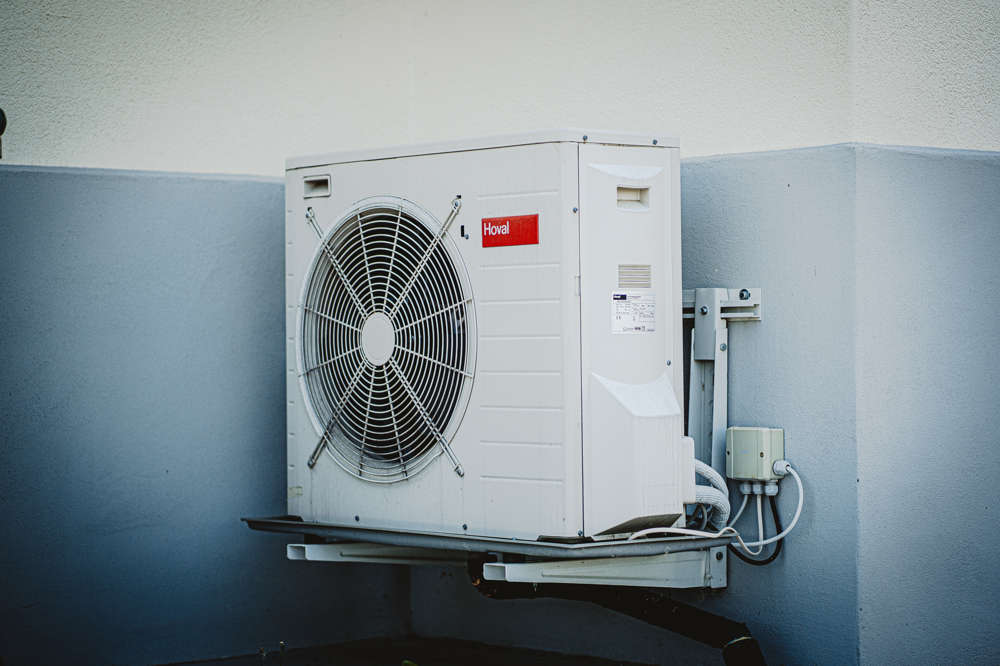
Photo by <a href="https://unsplash.com/@realbench?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Carlos Lindner</a> on <a href="https://unsplash.com/photos/white-and-gray-box-fan-53wcYH4IOig?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>

Before we progress from chains to forks it is worth spending some time exploring the concept of conditioning and the role it plays in DAGs in causal inference.

The literature states that conditining on the intermediary of a chain junction stops the flow of messages from the treatment to the outcome.

Again I was confused by this statement which is typically made without a detailed explanation in the literature, but as usual a few worked examples can clear the confusion away ...

### What is Conditioning?

#### Conditioning in Real-World Trials and Experiments

Outside of the techniques used in Causal Inference the gold-standard in establishing cause-effect relationships is the "Randomized Control Trial" (RCT) where (for example) patients are randomly allocated into two groups, one receiving a drug and the other a placebo. The theory goes that if the subjects have been selected at random and the "drug" group shows improved outcomes then there is causality.

Here is one potential definition of conditioning ...

<b>Conditioning in the context of Randomized Control Trials is the process of assigning participants to different treatment groups, often through randomization or stratification, to ensure unbiased comparisons and control for potential confounding variables.</b>

Beyond group assignment there is also mention of "stratification". Let us assume that we believe that the drug in question has different outcomes for different genders and / or for different ages. In this case the results of the drug trial experiment could be improved by "stratifying" the groups by gender / age (i.e. forming sub-groups based on these attributes) and then averaging the effect across these groups using the numbers of subjects in each.

Let's assume our trial group was split in two for male (60 subjects) and female (40 subjects). The stratified outcome of the drug effect would then be ...

$$
0.6 \times \text{the result for male subjects} + 0.4 \times \text{the result for female subjects}
$$

#### Conditioning in Causal Inference Models with Binary Data

That is great for RCTs but this type of group division may not be possible in CI models for several reasons. The data obtained may be historical so it is too late to organise the participants into groups. Also it may be unethical. If our causal problem involved smoking we could not randomly choose groups and instruct them to smoke or not smoke. Lastly it could be logistically impossible to achieve the organisation we want.

However, conditioning can be "simulated" in Causal Inference models in a way that achieves the same effect using a mathematical formula called "the Backdoor Adjustmwent Formula".

Consider the following DAG ...

A simple back-door DAG with a confounding fork between a treatment and outcome 



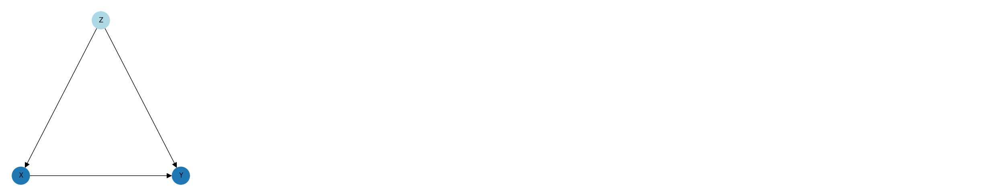

In [28]:
example_dag = DirectedAcyclicGraph.example_dags()["backdoor"]
print(example_dag["description"], "\n")

dag_backdoor: DirectedAcyclicGraph = example_dag["dag"]
dag_backdoor.draw(grid_size=5)

If we have a set of data for variables X, Y and Z and that data is binary (i.e. 1 = True / Yes and 0 = False / No) then it is possible to condition on Z (which clearly influences both the treatment X and the outcome Y) by applying the following formula to the data ...

$$
P(Y \mid do(X)) = \sum_{z} P(Y\mid X, Z=z)\ P(Z=z)
$$

The left hand side reads "what is the probability of Y given that we "do" X", for example "what is the probability of recovery=1 given that we do drug=1".

A full explanation of backdoor adjustment is outside of the scope of this article, but if you want to know more check this article out ...

#### Conditioning in Causal Inference Models with Continuous Data

Conditioning can also be simulated in CI models with continuous data by using a different method.

In the example above the chain X -> Z -> Y was evaluated using Ordinary Least Squares and regressed using this formula Y ~ X. There are several examples in the literature that state that to control for a variable in a CI model with continuous data the variable to be controlled for should simply be included in the regression i.e. Y ~ X should be replaced with Y ~ X, Z.

I have never found a good explanation as to why this works in any of the texts I have studied but I can confirm that it certainly does work by carrying out experiments in Python code and recording the results.

To see this in action let's return to the chain example ...

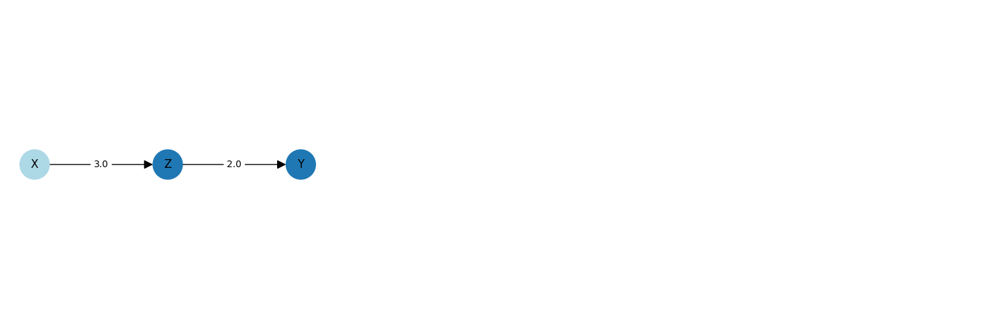

In [58]:
chain_causal_model.dag.draw(grid_size=3, labels=chain_causal_model.edge_weightings)

We have already established and explained what it means for messages to travel from X to Y in a chain and we have implemented this in Python noting that ...

$$
Y = -2.965 \times X
$$

In [30]:
ols_formula = "Y ~ X"
ols_results = ols(ols_formula, df_data).fit()

ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.877
Model:                            OLS   Adj. R-squared:                  0.877
Method:                 Least Squares   F-statistic:                     7129.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:27   Log-Likelihood:                -2022.9
No. Observations:                1000   AIC:                             4050.
Df Residuals:                     998   BIC:                             4060.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.1767      0.208     -0.850      0.396      -0.585       0.231
X             -2.9658      0.035    -84.431      0.000      -3.035      -2.897
==============================================================================
Omnibus:                        5.860   Durbin-Watson:                   1.963
Prob(Omnibus):                  0.053   Jarque-Bera (JB):                5.952
Skew:                          -0.185   Prob(JB):                       0.0510
Kurtosis:                       2.919   Cond. No.                         21.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""


... which is very close to the true result obtained by multiplying the co-efficient rZX by the co-efficient rYZ i.e. ...

$$
2.0 \times -1.5 = -3.0
$$

So if the claims in the various Causal Inference texts are correct it follows that if we condition on Z (by including it in the regression) then the co-efficient of -2.9658 for the effect of X on Y should disappear simply by including Z in the formaula ...

In [31]:
ols_formula = "Y ~ X + Z"
ols_results = ols(ols_formula, df_data).fit()

ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.939
Model:                            OLS   Adj. R-squared:                  0.939
Method:                 Least Squares   F-statistic:                     7669.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:27   Log-Likelihood:                -1673.3
No. Observations:                1000   AIC:                             3353.
Df Residuals:                     997   BIC:                             3367.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0205      0.147      0.140      0.889      -0.268       0.309
X              0.1035      0.100      1.038      0.300      -0.092       0.299
Z             -1.5482      0.049    -31.764      0.000      -1.644      -1.453
==============================================================================
Omnibus:                        0.665   Durbin-Watson:                   2.050
Prob(Omnibus):                  0.717   Jarque-Bera (JB):                0.536
Skew:                           0.008   Prob(JB):                        0.765
Kurtosis:                       3.112   Cond. No.                         48.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

By including Z in the regression the co-efficient of X has dropped from -2.9658 to 0.1 (i.e. disappeared) and the p-value has changed from 0.000 (refuting the null hypothesis that no association exists between X and Y) to 0.300 (accepting the null hypothesis that no association exists).

Given the lack of good explanations in the available literature I cannot explain why this works but I can verify through many Python experiments that it does work consistently enough to be included in Causal Inference models.

#### Conditioning in Causal Inference Models: Why Bother?

So what is the point of this detour? Well it transpires that being able to control the flow of messages around a Directed Acyclic Graph is a key concept in causal inference.

Returning to the example above ...

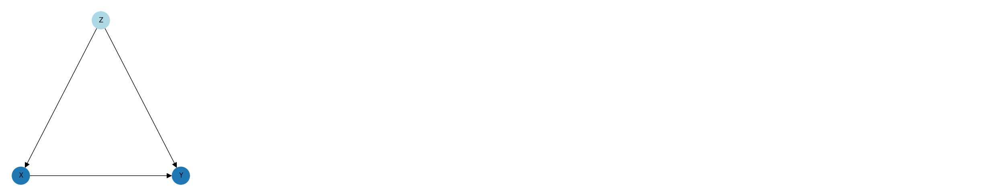

In [32]:
dag_backdoor.draw(grid_size=5)

... we know that if the data is binary we can apply the backdoor adjustment formula to calculate the deconfounded effect of X and Z but for continuous / non-binary data this approach does not work. However, now we understand that we can condition for Z by including it in the regression we have a method that works for continuous data as well.

Understanding the flow of messages around a DAG is also critically important in Causal Validation (where a proposed DAG is validated against the data in a real-world problem) and Causal Discovery (where an attempt is made to automatically infer the DAG from the data).

Armed with the knowledge gained in this detour we can now progress beyond chains to explore how messages are passed in forks and colliders.

## Recap

We have explored the defintiion and potential of Causal Inference models and the critical role that Directed Acyclic Graphs (DAGs) play.

DAGs contain nodes representing variables in the data. They contain a treatment node, and outcome nodes, other nodes that have a direct or indirect impact on the treatment and / or outcome and a set of uni-directional arrows indicating the causal links between each node / variable. 

DAGs are made up of a number of paths or routes through the network of nodes starting with the treatment and ending at the outcome. EAch of those paths is made up of junctions - a small section of path containing exactly 3 nodes - a start node, an end node and an intermediary.

Each junction conforms to one of just 3 patterns - chain, fork and collider.

Chains have been explored in detail and it has been shown that "messages" can pass from the start node to the end node in a chain but that if we condition on the intermediary node those messages are blocked and cannot flow through the chain junction.

We will now move onto the other two patterns - forks and colliders - to compare and contract them to chains and finally we will conclude as to how and why understnading and controlling the flow of messages through junctions, paths and DAGs is critical to causal inference models. 

## Forks

As with the chain pattern let's start by visualising a fork junction ...

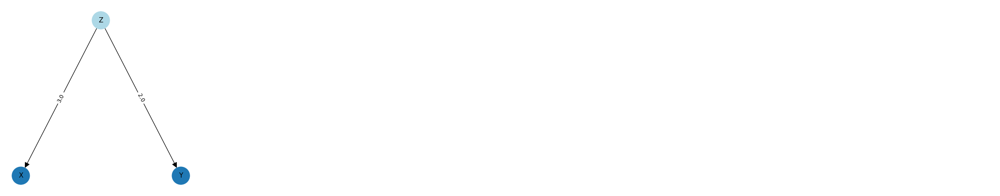

In [33]:
ic.disable()

fork_causal_model = create_display_model("simple_fork", display_results=False, override_random_seed=103)
fork_causal_model.dag.draw(grid_size=5, labels=fork_causal_model.edge_weightings)

All the Causal Inference literature states that in the chain pattern messages can flow from X (the treatment) to Y (the effect) and returning to the earlier defintion this means that if the value of variable X changes then the value of Y is changed.

This concept is easy to visualise for a chain where the causal arrows points from X to Z and Z to Y but for a long time I could not understand how this can work for a collider because the first causal arrow is pointing from Z to X so how can messages pass from X to Y in a chain junction?

As with most concepts in causal inference, what appears complex can be made simple through worked examples ...

#### Using Maths

The key to understanding the mathematical exploration of message passing in forks is to re-consider the relationship between X and Z ...

$$
\begin{array}{l}
⓵ \ X = 3Z \\

⓶ \ Y = 2Z \\ \\

Z = \frac{1}{3}X \ \ \ \text{(taking equation ⓵ and dividing both sides by 3)} \\
Y = 2 \times \frac{1}{3}X \ \ \ \text{(taking equation ⓶ and substituting equation ⓵ with both sides divided by 3)} \\
Y = \frac{2}{3}X
\end{array}
$$

The maths can be validated by creating a calculated column in the data by multiplying X by 2/3. The calculated column can then be compared to the value for Y noting that the structural equations include error terms so the calculated column should be close to the value of Y but will never be an exact match ...

In [34]:
test_data = fork_causal_model.data.copy(deep=True)
test_data["X * 2/3"] = test_data["X"] * (2/3)
test_data["difference"] = abs(test_data["X * 2/3"] - test_data["Y"])
test_data

,Z,X,Y,X * 2/3,difference
0,5.339657,16.026709,10.952998,10.684472,0.268526
1,4.436386,13.199983,8.559029,8.799989,0.240960
2,3.614817,10.405231,7.672793,6.936821,0.735973
3,7.621657,22.229451,15.641262,14.819634,0.821628
4,5.394845,17.630995,10.311580,11.753997,1.442417
...,...,...,...,...,...
995,4.714531,14.372388,9.532821,9.581592,0.048771
996,6.112224,18.158940,10.438862,12.105960,1.667098
997,4.436417,13.593722,9.013824,9.062481,0.048657
998,3.839339,11.701130,6.929749,7.800753,0.871005


As with the validation test performed for the chain we can see that the difference between the true value of Y (which includes an error term) and the value calculated by multiplying X by 2/3 is very similar thus proving that the maths used to calculate and demonstrate the flow of messages was correct.

### Using Correlation

Again, if there is an association between X and Y then this should be clearly visible if we plot the data points for X on the X axis against the data points for Y on the Y axis and also the line that best fits those datapoints should have a co-efficient that matches our calculated value for the effect of X on Y ...

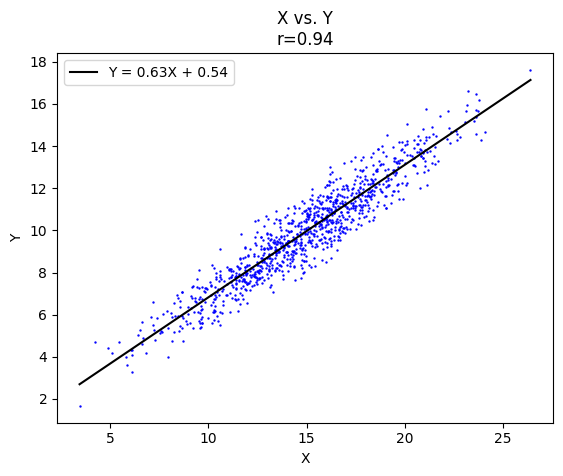

In [35]:
fork_causal_model.scatter_treatment_outcome(title="X vs. Y\n")

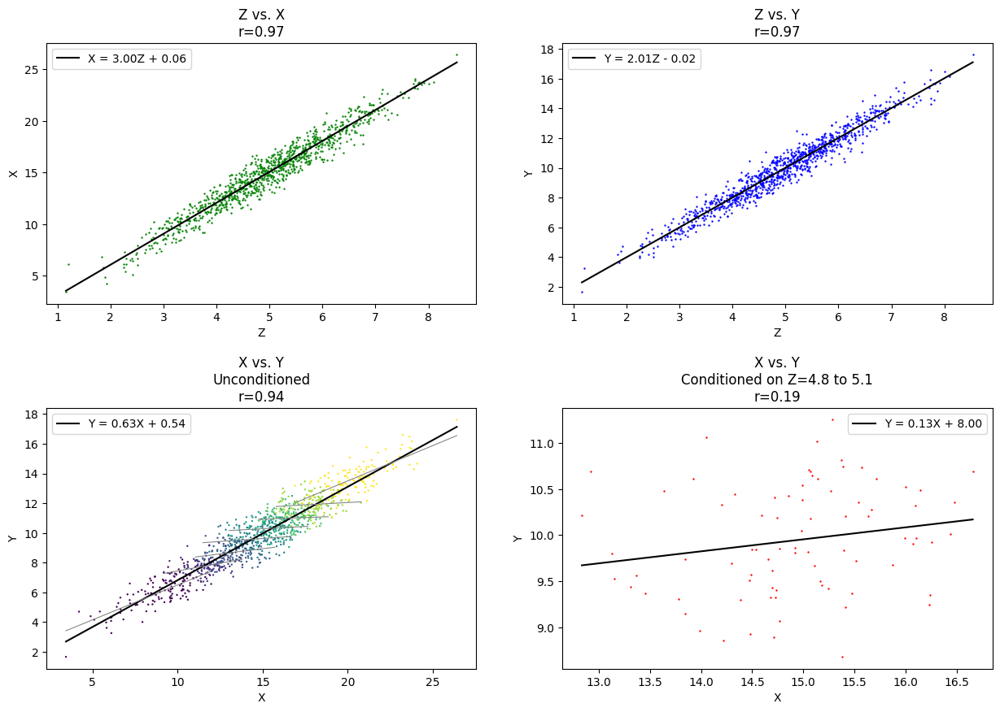

In [36]:
fork_causal_model.scatter_junction(junction = fork_causal_model.dag.junctions[0])

In [37]:
is_dependent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫̸ X")
is_dependent_on_unconditioned

True

In [38]:
ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.890
Model:                            OLS   Adj. R-squared:                  0.889
Method:                 Least Squares   F-statistic:                     8038.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:30   Log-Likelihood:                -1190.3
No. Observations:                1000   AIC:                             2385.
Df Residuals:                     998   BIC:                             2394.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5351      0.107      4.983      0.000       0.324       0.746
X              0.6288      0.007     89.656      0.000       0.615       0.643
==============================================================================
Omnibus:                        4.044   Durbin-Watson:                   2.005
Prob(Omnibus):                  0.132   Jarque-Bera (JB):                3.690
Skew:                           0.090   Prob(JB):                        0.158
Kurtosis:                       2.764   Cond. No.                         65.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [39]:
from sklearn.linear_model import LinearRegression

In [40]:
df_data = fork_causal_model.data

reg = LinearRegression().fit(df_data["X"].values.reshape(-1, 1), df_data["Y"])
intercept = reg.intercept_
gradient = reg.coef_[0]

print(gradient)
print(intercept)

0.62875262232752
0.5351367439223829


The scatter chart of X vs. Y confirms the maths and the co-efficient of the line is -0.63 which is very close to the result from the maths of 2/3 or 0.66. 

### Using Dependence

Returning to independence, the same relationship should hold true for X and Y ...
$$
% \perp is the ⊥ symbol, \!\!\! reverses 3 intervals and overlays another ⊥ giving ⫫
% \perp is ⊥ symbol then \!\!\!\!\!\! reverses 6 intervals, / is a sepeartor and finaly \ adds the slash giving ⫫̸
\providecommand{\independent}{\perp \!\!\! \perp}
\providecommand{\dependent}{\independent \!\!\!\!\!\! / \ }
\providecommand{\independentsingle}{\perp}
\providecommand{\dependentsingle}{\perp \!\!\!\!\!\! / \ }
\providecommand{\given}{\mid}
$$

$$
Y \dependent X
$$

... i.e. "Y is dependent on X" meaning that a change in X causes a change in Y and once again the Python extension for dependence referenced above can be used to demonstrate this formula in Python code ...

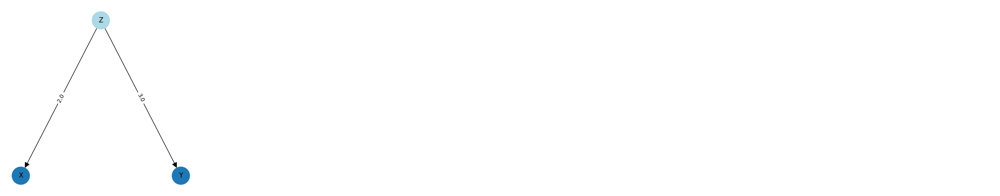

In [41]:
ic.disable()

fork_causal_model = create_display_model("simple_fork", display_results=False, override_random_seed=113)
fork_causal_model.dag.draw(grid_size=5, labels=fork_causal_model.edge_weightings)

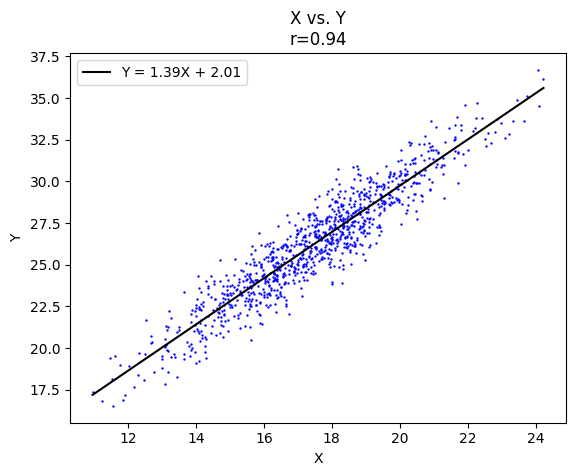

In [42]:
fork_causal_model.scatter_treatment_outcome(title="X vs. Y\n")

In [43]:
is_independent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫ X")
is_independent_on_unconditioned

False

In [44]:
is_independent_on_conditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫ X | Z")
is_independent_on_conditioned

True

In [45]:
is_dependent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫̸ X")
is_dependent_on_unconditioned

True

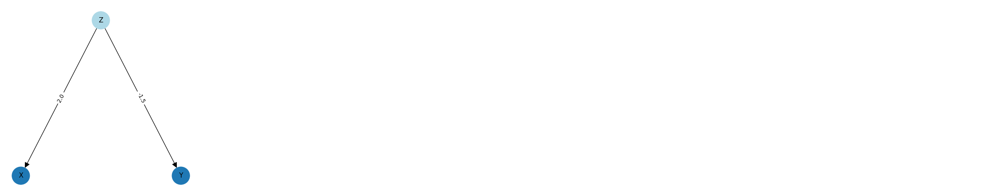

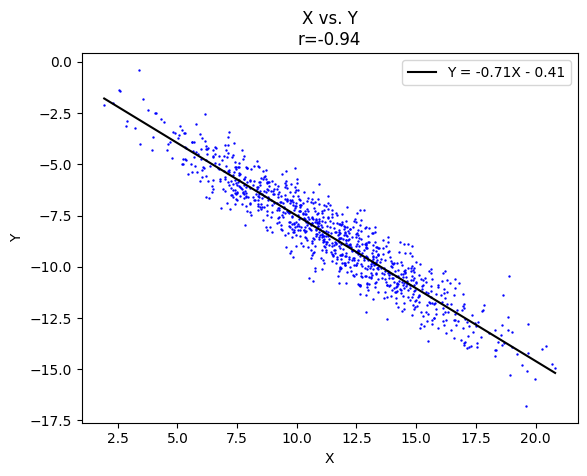

In [46]:
fork_causal_model = create_display_model("simple_fork", display_results=False, override_random_seed=101)
fork_causal_model.dag.draw(grid_size=5, labels=fork_causal_model.edge_weightings)
plt.show()
fork_causal_model.scatter_treatment_outcome(title="X vs. Y\n")
plt.show()

In [47]:
ic.enable()
is_dependent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫̸ X")
is_dependent_on_unconditioned

ic| expression: 'Y ⫫̸ X'


True

In [48]:
ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.884
Model:                            OLS   Adj. R-squared:                  0.884
Method:                 Least Squares   F-statistic:                     7633.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:32   Log-Likelihood:                -1274.6
No. Observations:                1000   AIC:                             2553.
Df Residuals:                     998   BIC:                             2563.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.4109      0.097     -4.257      0.000      -0.600      -0.221
X             -0.7095      0.008    -87.369      0.000      -0.725      -0.694
==============================================================================
Omnibus:                        0.007   Durbin-Watson:                   1.993
Prob(Omnibus):                  0.997   Jarque-Bera (JB):                0.005
Skew:                          -0.004   Prob(JB):                        0.997
Kurtosis:                       2.992   Cond. No.                         42.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

ic| 'CausalModel.fit'
ic| expr_str: 'X = 3 x Z + ε'
ic| expr_str: 'Y = 2 x Z + ε'
ic| expression: 'Y ⫫̸ X'
ic| expression: 'Y ⫫̸ X | Z'
ic| expression: 'Y ⫫ X | Z'


True

True
True


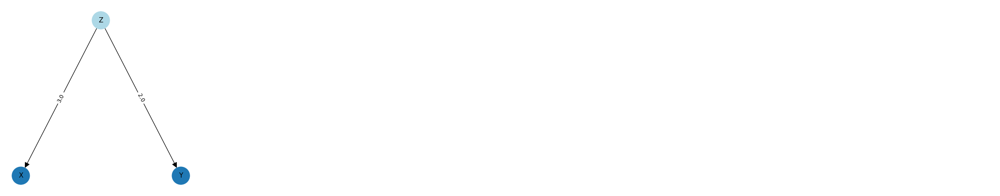

In [49]:
fork_causal_model = create_display_model("simple_fork", display_results=False, override_random_seed=103)
fork_causal_model.dag.draw(grid_size=5, labels=fork_causal_model.edge_weightings)
# df_data = fork_causal_model.data

# is_dependent_on_unconditioned, _, ols_results = df_data.dependence(expression="Y ⫫̸ X")
# is_dependent_on_unconditioned
df_data = fork_causal_model.data

is_dependent_on_unconditioned, _, ols_results = df_data.dependence(expression="Y ⫫̸ X")

is_dependent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫̸ X | Z")
is_independent_on_conditioned, _, ols_results = chain_causal_model.data.dependence(expression="Y ⫫ X | Z")

print(is_dependent_on_unconditioned)
print()
print(is_dependent_on_conditioned)
print(is_independent_on_conditioned)

In [50]:
ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.946
Model:                            OLS   Adj. R-squared:                  0.946
Method:                 Least Squares   F-statistic:                     8672.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:33   Log-Likelihood:                -2347.5
No. Observations:                1000   AIC:                             4701.
Df Residuals:                     997   BIC:                             4716.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept     -0.0327      0.141     -0.232      0.816      -0.309       0.244
X             -0.4415      0.193     -2.287      0.022      -0.820      -0.063
Z              2.1683      0.062     34.915      0.000       2.046       2.290
==============================================================================
Omnibus:                        1.867   Durbin-Watson:                   1.992
Prob(Omnibus):                  0.393   Jarque-Bera (JB):                1.863
Skew:                          -0.063   Prob(JB):                        0.394
Kurtosis:                       2.831   Cond. No.                         24.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

### Using Regression

The final visualising is the Ordinary Least Squares (OLS) regression and to see if the relationship exists in the output using the same approach as for the chain example ...

In [51]:
from statsmodels.formula.api import ols

ols_formula = "Y ~ X"
ols_results = ols(ols_formula, df_data).fit()

ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.890
Model:                            OLS   Adj. R-squared:                  0.889
Method:                 Least Squares   F-statistic:                     8038.
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        14:55:33   Log-Likelihood:                -1190.3
No. Observations:                1000   AIC:                             2385.
Df Residuals:                     998   BIC:                             2394.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5351      0.107      4.983      0.000       0.324       0.746
X              0.6288      0.007     89.656      0.000       0.615       0.643
==============================================================================
Omnibus:                        4.044   Durbin-Watson:                   2.005
Prob(Omnibus):                  0.132   Jarque-Bera (JB):                3.690
Skew:                           0.090   Prob(JB):                        0.158
Kurtosis:                       2.764   Cond. No.                         65.5
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

We can see from the results that the co-efficient of the line describing the effect of X on Y is 0.6288 which matches the results of the correlation method and the maths.

### Testing

The same testing was carried out for the fork junction pattern as for the chain i.e. 

1. Create a fork DAG.
2. Randomly generate the weightings on each causal arrow.
3. Generate a set of test data from those weightings.

AT THIS POINT WE KNOW WE HAVE A SET OF DATA AND A DAG THAT MATCH FOR THE CHAIN PATTERN X <- Z AND Z -> Y.

4. Now Use the dependency method from above to test these conditions ...
    - Test for Y ⫫̸ X (i.e that Y is dependent on X).
    - Test for Y ⫫ X | Z (i.e. that Y is independent of X when conditioned on Z).

IF BOTH THESE CHECKS ARE TRUE THEN THE DEPENDENCY CHECKS HAVE CONFIRMED THAT THE CONDITIONS FOR A CHAIN EXIST IN THE DATA.

5. Assess the true value of the effect of X on Y by multiplying the weightings together from the structural equations that were used to build the test data (see the maths section above).
6. Now run the regression test from the test data using the ordinary least squares method.

COMPARE THE TRUE VALUE OF THE EFFECT OF X ON Y TO THE REGRESSION TEST VALUE TO ASSESS THE ACCURACY OF THE REGRESSION TEST METHOD

8. Repeat steps 2. to 6. 100 times.
9. Review the results.

The results are that the dependency tests passed successfully in 100% of test cases and the calculated value for the effect of X on Y was 94.1% accurate

In [52]:
def test_fork(n_tests: int = 100):
    ic.disable()
    fork_tests_passed = 0
    accuracies = []

    for _ in range(n_tests):
        fork_causal_model = create_display_model("simple_fork", display_results=False)

        is_independent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫ X")
        is_independent_on_conditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫ X | Z")
        is_dependent_on_conditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫̸ X | Z")
        is_dependent_on_unconditioned, _, ols_results = fork_causal_model.data.dependence(expression="Y ⫫̸ X")

        if (is_dependent_on_conditioned == is_independent_on_conditioned):
            print(random_seed)
            
        if (is_dependent_on_unconditioned == True) and (is_independent_on_conditioned == True):
        #if (is_dependent_on_unconditioned == True) and (is_dependent_on_conditioned == False):

            fork_tests_passed += 1

            r_xz = fork_causal_model.edge_weightings[("Z", "X")]
            r_yz = fork_causal_model.edge_weightings[("Z", "Y")]
            
            r_yx = (1 / r_xz) * r_yz

            ols_change = ols_results.params["X"]

            accuracies.append(calculate_percentage_accuracy(ols_change, r_yx))

    print(f"Fork tests: {fork_tests_passed}/{n_tests} passed ({fork_tests_passed/n_tests:.1%})")
    print(f"The calculated effect of X on Y is {np.mean(np.array(accuracies)):.1%} accurate")

    ic.enable()

    return

In [53]:
random_seed = 100
test_fork()

113
151
158
163
Fork tests: 100/100 passed (100.0%)
The calculated effect of X on Y is 94.1% accurate


### Concluding Forks

We can see from 4 different methods - maths, correlation, dependence and regression - what it means when the causal literature states that messages can pass from the start to the end node in a fork junction and having 4 different ways of visualising this makes it easy to understand.

A quick closing note on forks ... if we condition on the intermediary in a fork junction, then message passing will be blocked in exactly the same way as it is in a chain.

#### Addressing the Elephant in the Room ...

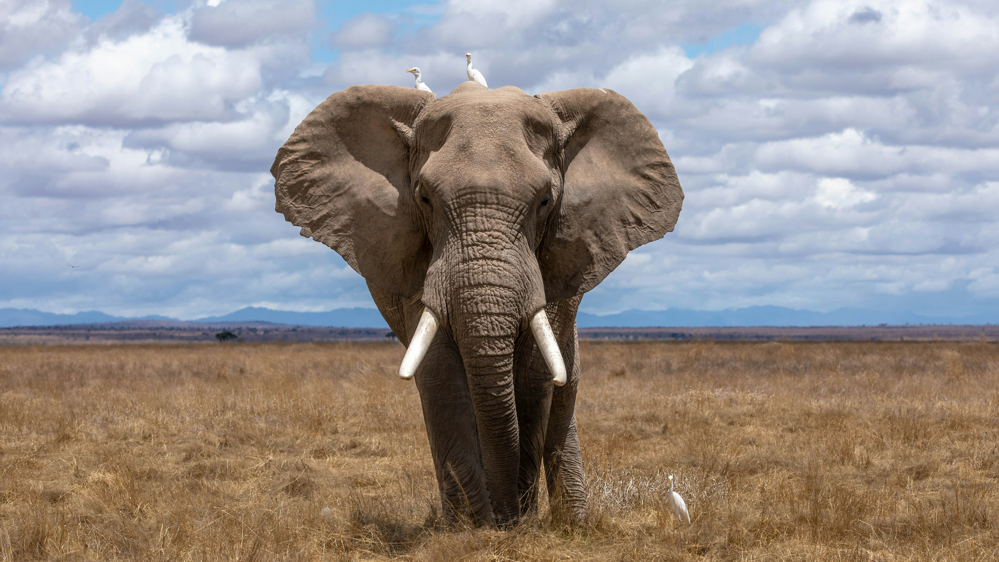
Photo by <a href="https://unsplash.com/@bepnamanh?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Nam Anh</a> on <a href="https://unsplash.com/photos/elephant-walking-during-daytime-QJbyG6O0ick?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>

One of the stated uses for understanding and influencing junctions is in causal validation where real world data is compared to a proposed DAG to check if the DAG has correctly captured the causality in the data.

However, you may have noticed that in the examples above chains and forks exhibit identical behaviour i.e. messages can pass through the both chains and forks but messages are blocked in both cases when conditioning on the intermediary and we can also see that the dependencey tests for chains and forks are identical (Y ⫫̸ X and Y ⫫ X | Z)

That certainly is an elephant in the room - if chains and forks exhbit the same behaviour and pass the same tests then how can all this knowledge be used to validate a DAG as these types of junctions cannot be differentiated?

Enter the "collider" pattern ...

## Colliders

As with the other two patterns let's start by visualising a collider junction using a DAG ...

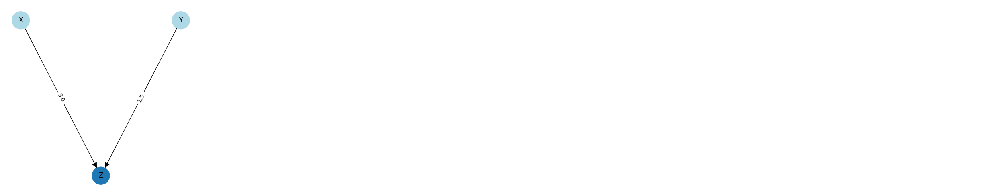

In [54]:
ic.disable()

collider_causal_model = create_display_model("simple_collider", display_results=False, override_random_seed=103)
collider_causal_model.dag.draw(grid_size=5, labels=collider_causal_model.edge_weightings)

The Causal Inference literature states that in the collider pattern messages cannot flow from X (the start node) to Y (the end node) and this means that if the value of variable X changes then the value of Y is does not change.

Colliders are harder to understand than the other two patterns so let's start with some real-world examples ...

Let's assume that we are modelling a sporting and academic college and the causes for students being given a bursary. In this example X represents a students sporting ability, Y represents their academic ability and Z represents the bursary. It is easier to visualise with this example that sporting ability causes bursary as students who are top sportsmen and sportswomen are awarded the bursary. We can also see the high academic achievement is a also a cause of bursary with academically gifted students being awarded bursaries.

If we change X (sporting ability) Y does not change in relation to that change because if you academic ability has a normal distribution for every level of sporting ability. It is not the case that better sports ability has a correlation with better academic achievement, rather they are independent and do not affect each other.

### Using Correlation

For forks the first visualisation is correlation because the maths is more complex and hence wil lbe tackled afterwards ...

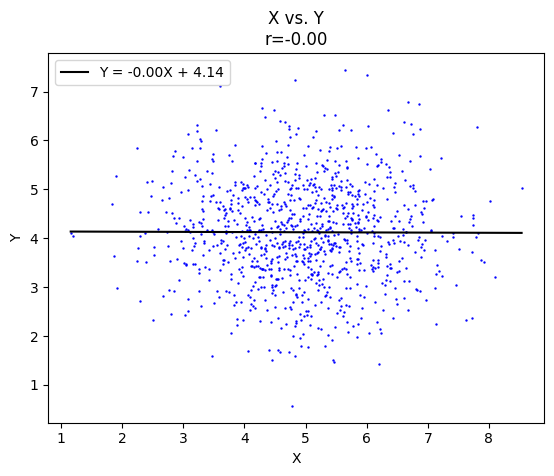

In [55]:
collider_causal_model.scatter_treatment_outcome(title="X vs. Y\n")

If X represents sporting ability and Y represents academic ability we can clearly see from the correlation that as sporting abilitychanges their is a no associated change in academic ability and the slope of the best-fit line is completely flat.

### Using Maths

At this point we shold probalbly mention that if we condition on the intermediary messages are passed from X to Y i.e. colliders are the exact opposite ofchains and forks. Taken as-is messages do not pass but condition on the intermediary and they do.

We can now progress with an attempt to visualise colliders using some maths noting that in the chain and fork the objective has been to simplify the equations to one that starts with "Y = ..."

$$
\begin{array}{l} % {array} lines everything up instead of the default centre justification
⓵ \ Z = 3.0X + 1.5Y \\
\\
1.5Y = Z - 3.0X \ \ \ \text{(taking equation ⓵ and subtracting 3.0X from both sides)} \\
Y = \dfrac{Z - 3.0X}{1.5 } \ \ \ \text{(dividing both sides by 1.5)} \\
\end{array}
$$

So we have solved the equation for Y but we are left with a term for Z whereas the examples for the chain and fork simlified to an expression for Y in terms of X.

The maths helps to explain why messages cannot pass from X to Y in a collider junction i.e. the equation cannot be simplified to Y = aX.

It also helps to explain why conditioning on Z (or fixing Z) does enable messages to pass from X to Y. For example let's assume in that Z is conditioned (i.e. fixed) to be 21 and see what happens to the equation ...

$$
\begin{array}{l} % {array} lines everything up instead of the default centre justification
⓵ \ Y = \dfrac{Z - 3.0X}{1.5 } \\
\\
Y = \dfrac{21 - 3.0X}{1.5} \ \ \ \text{(conditioning / fixing Z to be 21)} \\
\\
Y = \dfrac{21}{1.5} - \dfrac{3.0X}{1.5} \ \ \ \text{(dividing both elements of the numerator by 21)} \\
\\
Y = -2.0X + 14 \ \ \ \text{(completing the division on both sides of the minus sign)} \\
\end{array}
$$

In summary visualising a collider using mathematical equations clearly shows how messages cannot pass from X to Y (i.e. changing the value of X will not change the value of Y) but by conditioning on the intermediary messages do pass from X to Y.

This conslusion is critical to Causal Validation and Causal Discovery because it means that given a dataset and a proposed DAG we can differentiate between colliders and the other two types - chains and forks so if the DAG has proposed a collider incorrectly this can be identified.

### Using Dependence

For colliders there is a different dependence check ...

$$
Y \independent X
$$

The ⫫ symbol is a "double up-tack" and the formula above can be read as "Y is independent of X".

In fact,now we know all about conditioning we can add a second statements as follows ...

$$
Y \dependent X \given Z
$$

... which reads as "Y is dependent on X when consitioned on Z"

The Python code below will work if you have adopted the dataframe extensions described in the separate article ...

In [56]:
df_data = collider_causal_model.data

is_independent_on_unconditioned, _, ols_results = df_data.dependence(expression="Y ⫫ X")
is_dependent_on_conditioned, _, ols_results = df_data.dependence(expression="Y ⫫̸ X | Z")

print(is_independent_on_unconditioned)
print(is_dependent_on_conditioned)

True
True


### Using Regression

Lastly let's take a look at colliders using the regression method ...

In [57]:
from statsmodels.formula.api import ols

ols_formula = "Y ~ X"
ols_results = ols(ols_formula, df_data).fit()

ols_results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      Y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.001
Method:                 Least Squares   F-statistic:                   0.01734
Date:                Fri, 26 Jan 2024   Prob (F-statistic):              0.895
Time:                        14:55:38   Log-Likelihood:                -1451.3
No. Observations:                1000   AIC:                             2907.
Df Residuals:                     998   BIC:                             2916.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      4.1407      0.143     28.942      0.000       3.860       4.421
X             -0.0037      0.028     -0.132      0.895      -0.059       0.052
==============================================================================
Omnibus:                        0.045   Durbin-Watson:                   1.953
Prob(Omnibus):                  0.978   Jarque-Bera (JB):                0.029
Skew:                           0.013   Prob(JB):                        0.985
Kurtosis:                       3.001   Cond. No.                         23.0
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The co-efficient for X is close to zero (-0.0037) and the p-value is above 0.05 (0.895) accepting the null hypothesis that no association exists between X and Y.

### Concluding Colliders

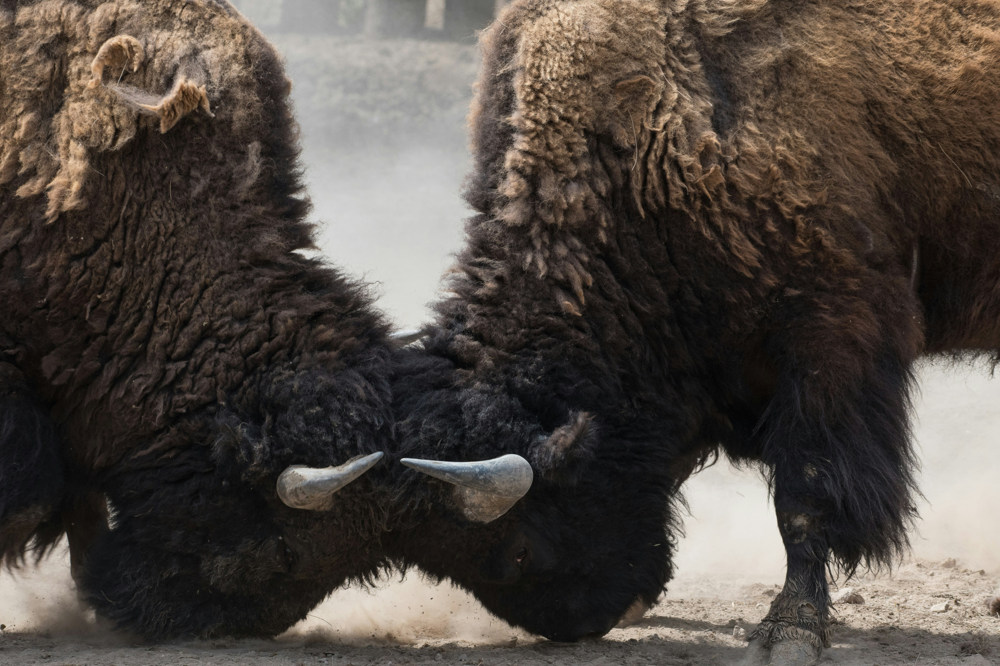
Photo by <a href="https://unsplash.com/@soberanes?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Uriel Soberanes</a> on <a href="https://unsplash.com/photos/two-bisons-fighting-head-L1bAGEWYCtk?utm_content=creditCopyText&utm_medium=referral&utm_source=unsplash">Unsplash</a>

Colliders occur less frequently than chains and forks in causal relationships but they have a very important property that makes them extremely useful.

We have already established that in chain and fork junctions messages can pass from the start node to the end node but when conditioning on the intermediary messages are blocked and that this similarity makes it impossible to differentiate chains and forks just by looking at the data.

Colliders however exhibit the opposite behaviour. Messages cannot pass from the start to the end node by default but when conditioning on the intermediary messages are unblocked.

And this key difference unlocks significant potential in causal modelling and particularly causal validation. In real-world causal modelling the data will always be the starting point and the DAG will have been developed through applying domain expertise which could result in errors in ommisions in the DAG.

The implementation of this aspect of causal validation will be for another article but the key principle is that if a collider exists in the data that was omitted in the DAG or a collider was added to the DAG that does not actually exist in the data then it can be detected and the DAG can be corrected.

## Conclusion

So what have we learned in this article?

We have learned that causal modelling has the potential for errors where a Directed Acyclic Graph developed using manual, domain expertise does not accurately or completely capture all the causal relationships that lie hidden in the data.

We have leanred that a DAG has a node representing each column or feature in the data and a set of uni-dorectional arrows pointing from one to the other indicating the flow of causality, that there is a single treatment or starting point and a single outcome or end point and that cycles or loops are not allowed.

Each DAG will have a number of paths or routes from the treatment to the outcome and each path is made up of 1 or more junctions, with each junction conforming to one of 3 patterns - a chain, a fork or a collider.

The junction then is the basic building block and understanding how they work is fundamental to understanding the bigger picture.

The accepted literature (books and articles) states that messages pass from the start to the end nodes in chains and forks and not in colliders and that the exact opposite is true when conditioning on the intermediary.

Usually the literature offers little or no explanation of the previous statement and that can lead to a fundamental lack of understnading of everything that is built on junctions all the way up to DAGs, causal modelling and causal validation.

In this article the key concept of message passing through junctions has been demystified by looking at each junction type in turn and providing 4 different way of looking at and under standing the "passing pf messages" and these 4 approaches are - maths, correlation, depedence and regression.

We also explained conditioning and how it is nothing more than holding the intermediary constant whilst considering the effect of the treatment on the outcome and then averaging the result for each possible value of the intermediary.

Causal modelling is a complex topic but it has the potential to unlock a new wave of data science solutions i.e. that not only can we explore what is going to happen (prediction) but why it is going to happen (causality) and whilst the former enables mitigating action the latter enables the underlying causes to be permanently addressed.

However to unlock that potential data scientists need to learn about a new set of approaches and this article has explained junctions and message passing in detail to help with that journey.